<a href="https://colab.research.google.com/github/higgsbelly/bitGANs-Generator/blob/main/BitGAN_Generator_Rev_1_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# BitGAN generator! Update, all notebooks work out of a **bitgan_folders** folder in your gdrive

![picture](https://lh3.googleusercontent.com/ZAMzH8NMiaYlxnGz7t2Fjjkdb-P-L9B2xBl2bPdGsIXlZYxdmcVdcV8JqHMUeJTyCMtankWwiJRAcANvxRN6ublwKJCuW4oO12B8cQ=s0)

**Rev 1-2 thanks to ricky! with a more functional gif generator**

This is meant to be a notbook to generate BitGANs for your own enjoyment. Or any GANs really. You can find me on twitter at https://twitter.com/higgsbelly 

**IMPORTANT, MAKE SURE Runtime>Change Runtime Type is set to GPU**

Mount your drive and grant permissions. I suggest making a copy of the notebook **File>Save a Copy in Drive** so if you mess something up you can easily start over. This will also allow you to come back to it more easily. **The only folder you will need to create is "gen". This is where your images will be pulled from.** They need to be **square, pixel size a multiple of 2, so 2x2, ..., 256x256, ".png", and "RGB or RGBA"**. The easiest way to upload multiple images at once to GDRIVE is drag and drop the folder, then rename it. It doesn't work well to select them all and try to drop them into a folder. **Drag and drop a folder from your desktop with the images straight into gdrive, then rename to gen!**

This first line of code is what mounts to your gdrive. You will need to grant permissions everytime you open this notebook or if you get disconnected.

In [ ]:
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    COLAB = True
    print("Note: using Google CoLab")
except:
    print("Note: not using Google CoLab")
    COLAB = False

Mounted at /content/drive
Note: using Google CoLab


See what GPU you are running if you are interested. It will not always be the same.

In [ ]:
!nvidia-smi

Sun Mar 27 04:30:20 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Now that your drive is mounted, you should be able to see it to left if you click the file folder. Don't get lost in there, there is a whole unix kernal.

The code below installs the GAN and some other necessary things. You will have to run it everytime you open the notebook for the first time. It takes a moment.

In [ ]:
!pip install lightweight-gan
!git clone https://github.com/lucidrains/lightweight-gan.git
!pip install ninja


     |████████████████████████████████| 493 kB 5.4 MB/s 
     |████████████████████████████████| 87 kB 5.2 MB/s 
  Created wheel for fire: filename=fire-0.4.0-py2.py3-none-any.whl size=115942 sha256=0947744c1c55fc5ecf127ecd43f8040137d740b44892e2158d725d689a2e81b3
  Stored in directory: /root/.cache/pip/wheels/8a/67/fb/2e8a12fa16661b9d5af1f654bd199366799740a85c64981226
Successfully built fire
Cloning into 'lightweight-gan'...
remote: Enumerating objects: 864, done.
remote: Counting objects: 100% (109/109), done.
remote: Compressing objects: 100% (78/78), done.
remote: Total 864 (delta 61), reused 52 (delta 20), pack-reused 755
Receiving objects: 100% (864/864), 12.17 MiB | 12.05 MiB/s, done.
Resolving deltas: 100% (497/497), done.
     |████████████████████████████████| 108 kB 4.2 MB/s 


Below you are importng all the modules that this code needs to run. All of the code cells are meant for python, if the code has a "!" in front, that is doing something in the terminal. 

In [ ]:
import os
import random
import shutil
import subprocess
import json
import multiprocessing
import math
from math import log2, floor
from functools import partial
from contextlib import contextmanager, ExitStack
from pathlib import Path

import torch
from torch.cuda.amp import autocast, GradScaler
from torch.optim import Adam
from torch import nn, einsum
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torch.autograd import grad as torch_grad
from torch.utils.data.distributed import DistributedSampler
from torch.nn.parallel import DistributedDataParallel as DDP

from PIL import Image, ImageDraw, ImageOps
import torchvision
from torchvision import transforms
from kornia.filters import filter2d

from lightweight_gan.diff_augment import DiffAugment
from lightweight_gan.version import __version__

from tqdm import tqdm
from einops import rearrange, reduce, repeat

from adabelief_pytorch import AdaBelief


This is where the magic happens! You are about to train the GAN!

You have to keep this window open while you train. Because the free version of Google Colab is running this on their server, it wants to make sure you are not taking advantage of free GPU power on an expensive machine. Periodically google will check to see if you are there, and if you run it long enough, kick you out. If the session was terminated, you will have to start over. If its in the same session, the code can pick up where you left off. 

There are a few options in this line of code you may want to play with, what is presented are the settings I found to work best. 

**lightweight_gan** This your GAN, not optional

**--data** This is where your images you wish to train on are stored, optional

**--name** this is what you are naming this run, optional, but referenced further down the road

**--results_dir** this is where you will save the results, important, these are what you are looking to make a gif from, optional, referenced later

**--gradient-accumulate-every** This I don't know as much about, it is related to the batch size and needs to be an integer (1, 2, 3, ...) As the batch size goes down, in the normal world of GAN training, gradient accumulation should go up as I understand it. When you are making  bitGANs you want to see all the steps. I set batch size and gradient accumullation low to generate a smoother GIF. Optional.

**--image-size** This is the size of the results image. Optional. 1024 not suggested but possible. 

**--amp** You can leave this out, its just a setting that allows for mixed precision. Mixed percision has to do with how numbers are stored in the program, i.e. float16, float32 so on. Having it in on my local machine makes the fan on my GPU more quiet becuase it doesn't have to work as hard. Optional

**--disc-output-size** This is the size of the grid used when comparing the real and fake images. Seems like 5x5 works better than 1x1 the default. Optional

**--save_every and --evaluate_every** This is where you tell it how often to save the images. I've set it at 50 to generate the GAN more quickly but still give enough material for a smooth GIF. Pindar suggests 10 for your final product. They have to be the same number and it needs to be an integer. When you are testing something, you can set it to 250 or 1000 if you want to get a quick look. Optional

**--num-train-steps** This is set to 4000, this will be the number of kimgs or 1000 images iterated through? Optional. Default is set to 150000, but we don't need that many to make a BitGAN.

**What am I looking at below while this code runs?** Congrats! Your code is runnning! You are making BitGANs or zeus knows what else. The percent is not a representation of how close your images look to the real deal, its just how far you've made it through **--num-train-steps**. I typically go into Gdrive in another tab to look at the outputs while its running. If you want to stop it, you will have to click in the line of code that is executing and then the square.

So for example, I could run **!lightweight_gan --data /content/drive/MyDrive/bitgan_folders/gen --name bitgan --results_dir /content/drive/MyDrive/bitgan_folders/results --gradient-accumulate-every 1 --image-size 512 --batch-size 4 --disc-output-size 5 --amp --save_every 50 --evaluate_every 50**  

This will run slower because my outputs are of higher resolution, I also increased the batch size to 4 to see what might happen. 

The second line of code will run your progress images right after the first line finishes. I put this in here to prevent colab from timing out between the steps as you would have to start over. Continue below for explanation on the generatation of the progress images.




In [ ]:
!lightweight_gan --data /content/drive/MyDrive/bitgan_folders/gen --name bitgan --results_dir /content/drive/MyDrive/bitgan_folders/results --gradient-accumulate-every 2 --image-size 512 --batch-size 4 --disc-output-size 5 --attn-res-layers [] --amp --save_every 10 --evaluate_every 10 --num-train-steps 4000
!lightweight_gan --data /content/drive/MyDrive/bitgan_folders/results --name bitgan --results_dir /content/drive/MyDrive/bitgan_folders/results --show-progress --generate-types default 

autosetting augmentation probability to 30%
bitgan</content/drive/MyDrive/bitGAN/gen>:   1% 50/4000 [00:35<46:11,  1.43it/s]G: 1.36 | D: 0.84 | GP: 0.07 | SS: 0.62
bitgan</content/drive/MyDrive/bitGAN/gen>:   2% 100/4000 [01:04<42:12,  1.54it/s]G: 8.01 | D: 0.00 | GP: 0.15 | SS: 0.75
bitgan</content/drive/MyDrive/bitGAN/gen>:   4% 150/4000 [01:35<40:40,  1.58it/s]G: 1.20 | D: 0.20 | GP: 0.01 | SS: 0.47
bitgan</content/drive/MyDrive/bitGAN/gen>:   5% 200/4000 [02:05<39:38,  1.60it/s]G: 6.16 | D: 1.11 | GP: 0.74 | SS: 0.26
bitgan</content/drive/MyDrive/bitGAN/gen>:   6% 250/4000 [02:35<38:50,  1.61it/s]G: 1.44 | D: 1.20 | GP: 0.93 | SS: 0.16
bitgan</content/drive/MyDrive/bitGAN/gen>:   8% 300/4000 [03:05<38:08,  1.62it/s]G: 0.89 | D: 0.00 | GP: 0.01 | SS: 0.25
bitgan</content/drive/MyDrive/bitGAN/gen>:   9% 350/4000 [03:36<37:35,  1.62it/s]G: 3.39 | D: 0.00 | GP: 0.03 | SS: 0.12
bitgan</content/drive/MyDrive/bitGAN/gen>:  10% 400/4000 [04:06<36:58,  1.62it/s]G: 3.19 | D: 0.66 | GP: 0.17 

**I've commented out the code below so you don't accidentally run it again, as it is in the line above if you let it run all the way through. Alternatively, if you stopped the above code, but still want to run show progress, delete the hashtag and hit run.**

Alright! Now we have some images!!! Not done yet. I don't totally understand what this does, but it compiles your images. This is actually what the GAN was generating. The code below looks similar to the above, it just has **--show-progress** in there. If you changed the **--name**, it needs to match here. You can actually run this multiple times and get different results. If you do this, edit the **results_dir** so you don't save over them. Alternatively, move the results to a different fodler. Also, notice there are two types of images in the results folder from GAN training. **--generate-types** can take either **ema** or **default**. After you run this, it creates a new folder **project-name-progress** These are the raw jpg files of your GAN working towards the goal line. 

In [ ]:
#!lightweight_gan --data /content/drive/MyDrive/results --name bitgan --results_dir /content/drive/MyDrive/results --show-progress --generate-types default 

If you don't have photoshop or gimp(free open source), this will take those images and create a gif for you **out.gif**. It will then save it in your results folder. Remember, if you are making multiple runs and changing file names, it will need to be changed here as well or you may save over files unintentionally. **Change the number of the skip variable to the number of the image you would like to start from**

In [ ]:
run_name = 'bitgan'
gif_name = 'out.gif'
drive_path = '/content/drive/MyDrive/bitgan_folders/results/'
folder = drive_path + run_name + '-progress/'

outputs = [f for f in os.listdir(folder) if os.path.isfile(os.path.join(folder, f))]
outputs = sorted(outputs)

skip = 20 # This is the image you would like to start from
N = len(outputs)
images = []
for i in range(skip, N):
  im = Image.open(folder + outputs[i])
  im = im.convert('RGBA')
  images.append(im)

first_im = images[0]
j = len(images) 
k = j - 5

for i in range(k,j): #Blends in first image to last 5 for a smoother transition
  b = i - (k-1)
  a = b*51
  first_im.putalpha(a)
  images[i].paste(first_im, (0,0), first_im)
images[0].save(drive_path + gif_name,save_all=True, append_images=images[1:], optimize=False, duration=100, loop=0)



Hit play and it should spit out the gifs of what your GAN made. This can be downloaded from your GDrive and cropped, edited, or whatever you please. The 8 or so BitGANs should all be different but similar. If you opted for a larger image size, it does get fussy. Downloading the file is recommended if this is the case.

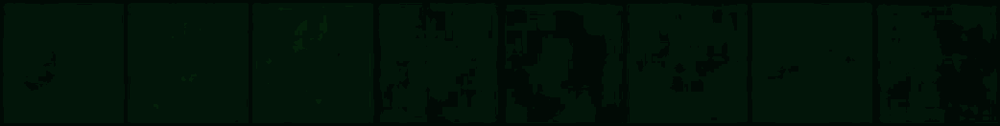

In [ ]:
from IPython.display import Image
Image(open(drive_path + gif_name,'rb').read())

## Credit and Documentation

A huge thank you to Pindar for help with making my own GANs that spurred this intensive coding journey. Its pretty crazy that I was playing with GPUs in 2010 and then never did anything with it. Happy to be back and playing with code. If you are curious where I started with this check out: https://www.youtube.com/watch?v=L3JLzoe-dJU&list=PLotIRx34SC_VNRh7NHm0NhQQzN7At2Xft&index=4&t=7s

Jeff has a ton of  videos that were very helpful when I was trying to get a GAN running. Ultimately I setup a local development environment because using the GAN in this video was too difficult with the time constraints in Google Colab. Do the like subscribe thing, hes got a great channel if you want to dive deeper into GANs.

This is the GAN that you are running https://github.com/lucidrains/lightweight-gan licensed under MIT, free to use and "lightweight" enough for my baby laptop GPU. 

Finally, thank you to Dr. Bryant Wyatt. He, Myself, and Brett Hokr  built what is now kown as the Tarleton Particle Modeling Group back in 2010 at a Texas Rodeo College. https://www.youtube.com/channel/UCbkVkINAwMrAz6r0ku7f8lA

